In [1]:
import pandas as pd
import numpy as np
from pandas.tseries.offsets import MonthEnd
import calendar
import matplotlib.pyplot as plt
import plotly.express as px

### Import df1 as df

In [2]:
# Import data
file_path = r'Data_OC\df1.parquet'
df1 = pd.read_parquet(file_path, engine='pyarrow')
pd.set_option('display.max_columns', None)

#print(df.columns.tolist())

In [ ]:
#df1.head()
#df1.describe()

In [3]:
# code that drop the date that we dont need in the first analysis and correct the data not correct in the file setting the right
#format

df2 = df1.copy()

# Identify and drop columns to drop that contain 'data' (case-insensitive)
data_columns_drop = [col for col in df2.columns if 'data' in col]
df2 = df2.drop(columns=data_columns_drop)

# Identify columns to keep that contain 'DATA' (case-sensitive)
data_columns = [col for col in df2.columns if 'DATA' in col]

df2[data_columns] = df2[data_columns].fillna(0).astype(int)

# Correct invalid dates
for col in df2[data_columns].columns:
    corrected_dates = []
    for date in df2[col]:
        # Ensure date is a string in YYYYMMDD format
        date_str = str(date).zfill(8)
        year = int(date_str[:4])  # Extract year
        month = int(date_str[4:6])  # Extract month
        day = int(date_str[6:])  # Extract day

 #       # Get the last valid day of the month
        try:
            last_day = calendar.monthrange(year, month)[1]
        except ValueError:
            # Handle invalid months (e.g., month > 12)
            last_day = 0

        # Adjust the day if it exceeds the valid range
        if day > last_day or day == 0:
            day = last_day

        # Construct the corrected date
        corrected_date = f"{year:04d}{month:02d}{day:02d}"
        corrected_dates.append(corrected_date)

    # Update the column with corrected dates
    df2[col] = corrected_dates

# Convert the corrected columns to datetime
for col in df2[data_columns].columns:
    df2[col] = pd.to_datetime(df2[col], format='%Y%m%d', errors='coerce')

# Display the corrected DataFrame
df2.head()


,cod_locale_progetto,cup,oc_titolo_progetto,oc_sintesi_progetto,oc_link,OC_COD_CICLO,OC_DESCR_CICLO,OC_COD_TEMA_SINTETICO,OC_TEMA_SINTETICO,COD_GRANDE_PROGETTO,DESCRIZIONE_GRANDE_PROGETTO,OC_COD_FONTE,OC_DESCR_FONTE,FONDO_COMUNITARIO,OC_CODICE_PROGRAMMA,OC_DESCRIZIONE_PROGRAMMA,COD_OB_TEMATICO,DESCR_OB_TEMATICO,COD_PRIORITA_INVEST,DESCR_PRIORITA_INVEST,OC_COD_CATEGORIA_SPESA,OC_DESCR_CATEGORIA_SPESA,OC_ARTICOLAZIONE_PROGRAMMA,OC_SUBARTICOLAZIONE_PROGRAMMA,OC_COD_ARTICOLAZ_PROGRAMMA,OC_DESCR_ARTICOLAZ_PROGRAMMA,OC_COD_SUBARTICOLAZ_PROGRAMMA,OC_DESCR_SUBARTICOLAZ_PROGRAMMA,COD_STRUMENTO,DESCR_STRUMENTO,DESCR_TIPO_STRUMENTO,CUP_COD_NATURA,CUP_DESCR_NATURA,CUP_COD_TIPOLOGIA,CUP_DESCR_TIPOLOGIA,CUP_COD_SETTORE,CUP_DESCR_SETTORE,CUP_COD_SOTTOSETTORE,CUP_DESCR_SOTTOSETTORE,CUP_COD_CATEGORIA,CUP_DESCR_CATEGORIA,COD_ATECO,DESCRIZIONE_ATECO,OC_COD_TIPO_AIUTO,OC_DESCR_TIPO_AIUTO,COD_REGIONE,DEN_REGIONE,COD_PROVINCIA,DEN_PROVINCIA,COD_COMUNE,DEN_COMUNE,OC_MACROAREA,OC_COD_SLL,OC_DENOMINAZIONE_SLL,FINANZ_UE,FINANZ_UE_FESR,FINANZ_UE_FSE,FINANZ_UE_FEASR,FINANZ_UE_FEAMP,FINANZ_UE_IOG,FINANZ_STATO_FONDO_DI_ROTAZIONE,FINANZ_STATO_FSC,FINANZ_STATO_PAC,FINANZ_STATO_COMPLETAMENTI,FINANZ_STATO_ALTRI_PROVVEDIMENTI,FINANZ_REGIONE,FINANZ_PROVINCIA,FINANZ_COMUNE,FINANZ_RISORSE_LIBERATE,FINANZ_ALTRO_PUBBLICO,FINANZ_STATO_ESTERO,FINANZ_PRIVATO,FINANZ_DA_REPERIRE,FINANZ_TOTALE_PUBBLICO,ECONOMIE_TOTALI,ECONOMIE_TOTALI_PUBBLICHE,OC_FINANZ_UE_NETTO,OC_FINANZ_UE_FESR_NETTO,OC_FINANZ_UE_FSE_NETTO,OC_FINANZ_UE_FEASR_NETTO,OC_FINANZ_UE_FEAMP_NETTO,OC_FINANZ_UE_IOG_NETTO,OC_FINANZ_Stato_Fondo_Rot_NETTO,OC_FINANZ_Stato_FSC_NETTO,OC_FINANZ_Stato_PAC_NETTO,OC_FINANZ_Stato_compl_NETTO,OC_FINANZ_Stato_altri_prov_NETTO,OC_FINANZ_Regione_NETTO,OC_FINANZ_Provincia_NETTO,OC_FINANZ_Comune_NETTO,OC_FINANZ_Risorse_liberate_NETTO,OC_FINANZ_Altro_pubblico_NETTO,OC_FINANZ_Stato_estero_NETTO,OC_FINANZ_Privato_NETTO,OC_FINANZ_TOT_PUB_NETTO,OC_COSTO_COESIONE,IMPEGNI,OC_IMPEGNI_GIURID_VINCOLANTI,OC_IMPEGNI_TRASFERIMENTI,OC_IMPEGNI_COESIONE,TOT_PAGAMENTI,OC_TOT_PAGAMENTI_BENEFICIARI,OC_TOT_PAGAMENTI_TRASFERIMENTI,COSTO_REALIZZATO,COSTO_RENDICONTABILE_UE,OC_TOT_PAGAMENTI_RENDICONTAB_UE,OC_TOT_PAGAMENTI_FSC,OC_TOT_PAGAMENTI_PAC,OC_PAGAMENTI_COESIONE,OC_DATA_INIZIO_PROGETTO,OC_DATA_FINE_PROGETTO_PREVISTA,OC_DATA_FINE_PROGETTO_EFFETTIVA,OC_STATO_FINANZIARIO,OC_STATO_PROGETTO,OC_STATO_PROCEDURALE,OC_COD_FASE_CORRENTE,OC_DESCR_FASE_CORRENTE,COD_PROCED_ATTIVAZIONE,DESCR_PROCED_ATTIVAZIONE,COD_TIPO_PROCED_ATTIVAZIONE,DESCR_TIPO_PROCED_ATTIVAZIONE,OC_CODFISC_PROGRAMMATORE,OC_DENOM_PROGRAMMATORE,OC_COD_FORMA_GIU_PROGRAMMATORE,OC_DESCR_FORMA_GIU_PROGRAMMATORE,OC_TOTALE_PROGRAMMATORI,OC_CODFISC_ATTUATORE,OC_DENOM_ATTUATORE,OC_COD_FORMA_GIU_ATTUATORE,OC_DESCR_FORMA_GIU_ATTUATORE,OC_TOTALE_ATTUATORI,OC_CODFISC_BENEFICIARIO,OC_DENOM_BENEFICIARIO,OC_COD_FORMA_GIU_BENEFICIARIO,OC_DESCR_FORMA_GIU_BENEFICIARIO,OC_TOTALE_BENEFICIARI,OC_CODFISC_REALIZZATORE,OC_DENOM_REALIZZATORE,OC_COD_FORMA_GIU_REALIZZATORE,OC_DESCR_FORMA_GIU_REALIZZATORE,OC_TOTALE_REALIZZATORI,OC_TOTALE_INDICATORI,COD_INDICATORE_1,DESCR_INDICATORE_1,UNITA_MISURA_INDICATORE_1,PROGRAMMATO_INDICATORE_1,REALIZZATO_INDICATORE_1,COD_INDICATORE_2,DESCR_INDICATORE_2,UNITA_MISURA_INDICATORE_2,PROGRAMMATO_INDICATORE_2,REALIZZATO_INDICATORE_2,COD_INDICATORE_3,DESCR_INDICATORE_3,UNITA_MISURA_INDICATORE_3,PROGRAMMATO_INDICATORE_3,REALIZZATO_INDICATORE_3,COD_INDICATORE_4,DESCR_INDICATORE_4,UNITA_MISURA_INDICATORE_4,PROGRAMMATO_INDICATORE_4,REALIZZATO_INDICATORE_4,OC_FLAG_REGIONE_UNICA,OC_FLAG_VISUALIZZAZIONE,OC_FLAG_PAC,DATA_AGGIORNAMENTO,OC_FLAG_CUP,Fonte_Calc
0,11FR103176,D59F20000220007,INFORMATIZZAZIONE E POTENZIAMENTO DEI PROCESSI,LA SOCIETÃ INTENDE AGGIORNARE IL PROPRIO SIST...,www.opencoesione.gov.it/progetti/11fr103176,2.0,Ciclo di programmazione 2014-2020,01,Ricerca e innovazione,None,None,FS1420,Fondi Strutturali relativi alla programmazione...,FESR,2014IT16RFOP009,POR FESR FRIULI-VENEZIA GIULIA,01,"Rafforzare la ricerca, lo sviluppo tecn

In [4]:
# drop columns if nan is > 40%

# Calculate the percentage of NaN or null values for each column in df2
nan_percentage = (df2.isnull().sum() / len(df2)) * 100

# Identify columns where the percentage of NaN is greater than 40%
columns_to_drop = nan_percentage[nan_percentage > 40].index

# Drop these columns from the DataFrame
df2 = df2.drop(columns=columns_to_drop)

In [5]:
# Indicator_2 still contains 14% of NaN values, but it is not very relevant in the initial approximation for the objective, so we are dropping it

df2 = df2.drop(columns=df2.columns[df2.columns.str.contains('INDICATORE_2')])

In [6]:
#There are records that do not have an actual end date; in this case, we insert 31.12.2999 as a placeholder to indicate that it has not ended.

df2['OC_DATA_FINE_PROGETTO_EFFETTIVA'] = df2['OC_DATA_FINE_PROGETTO_EFFETTIVA'].replace(['null', None, pd.NaT], '31.12.2099')
df2['OC_DATA_FINE_PROGETTO_EFFETTIVA'] = pd.to_datetime(df2['OC_DATA_FINE_PROGETTO_EFFETTIVA'], dayfirst=True)

In [7]:
#At this point, I remove the remaining records since they are below 6%.

columns_with_nan = df2.columns[df2.isnull().any()]

df2 = df2.dropna(subset=columns_with_nan).reset_index(drop=True)

In [8]:
# The remaining residues at 25% are currently being removed; the columns are two and relate to the revolving fund.: 

# Calculate the percentage of NaN or null values for each column in df2
nan_percentage = (df2.isnull().sum() / len(df2)) * 100

# Identify columns where the percentage of NaN is greater than 25%
columns_to_drop = nan_percentage[nan_percentage > 25].index

# Drop these columns from the DataFrame
df2 = df2.drop(columns=columns_to_drop)

In [9]:
# Calculate the percentage of NaN or null values for each column in df2
nan_percentage = (df2.isnull().sum() / len(df2)) * 100

# Convert to a DataFrame for better readability
nan_percentage_df = nan_percentage.reset_index()
nan_percentage_df.columns = ['Column', 'Percentage of NaN']

# Sort the DataFrame by percentage in descending order for better visualization
nan_percentage_df = nan_percentage_df.sort_values(by='Percentage of NaN', ascending=False)

# Display the results for percentage > 0
filtered_nan_percentage_df = nan_percentage_df[nan_percentage_df['Percentage of NaN'] > 0]
print(filtered_nan_percentage_df.to_string(index=False))


Empty DataFrame
Columns: [Column, Percentage of NaN]
Index: []


In [10]:
df_lav=df2.copy()

In [12]:
df_lav.to_csv('data_output/df_lav.csv')

# Apply analitical classification:

define delay and Perc_contrib_nok to take out a criterio to classify.

- delay - to verify the amount of delay in days
- Perc_contrib_nok -- to verify the percentage of value not as expenses.
- prj_duration_pred -- project duration predicted
- marginal_cost -- value of the project per day

# Classification is made by a function considering:
Function: classify_risk, determines the level of risk based on two factors: the delay (in days) and the percentage of non-EU contributions (Perc_No_Ue). The logic works as follows:

### High Risk (Level 3):
If the delay exceeds or equal 1825 days, or If the percentage of non-EU contributions is 50% or higher.
These conditions indicate a very high level of risk.

### Moderate Risk (Level 2):
If the delay is 365 days and 1825 days, or If the percentage of non-EU contributions is between 25% and 50% .
These situations represent a medium level of risk.

### Low Risk (Level 1):
If the delay is **between** 180 days) and 365 days , or If the percentage of non-EU contributions is between 15% and 25% .
These cases indicate a low level of risk.

### No Risk (Level 0):
If none of the above conditions are met. This represents the absence of significant risk.

In [13]:
df_lav['delay'] = (df_lav['OC_DATA_FINE_PROGETTO_EFFETTIVA'] - df_lav['OC_DATA_FINE_PROGETTO_PREVISTA']).dt.days
df_lav['prj_duration_pred'] = (df_lav['OC_DATA_FINE_PROGETTO_PREVISTA'] - df_lav['OC_DATA_INIZIO_PROGETTO']).dt.days
df_lav['Perc_contrib_nok'] = (1-(df_lav['COSTO_RENDICONTABILE_UE']/df_lav['OC_FINANZ_TOT_PUB_NETTO']))

# Calcolare 'marginal_cost' gestendo la divisione per zero
df_lav['marginal_cost'] = np.where(
    df_lav['prj_duration_pred'] == 0,  # Condizione
    999999999,                        # Valore per divisione per zero
    df_lav['FINANZ_TOTALE_PUBBLICO'] / df_lav['prj_duration_pred']  # Valore normale
)
rows_to_drop = df_lav[df_lav['marginal_cost'] == 999999999]
df_lav = df_lav.drop(rows_to_drop.index)

In [14]:
df_lav['DEN_REGIONE_new'] = df_lav['DEN_REGIONE'].apply(lambda x: 'Multi' if ':::' in str(x) else x)
df_lav['DEN_PROVINCIA_new'] = df_lav['DEN_PROVINCIA'].apply(lambda x: 'Multi' if ':::' in str(x) else x)
df_lav['DEN_COMUNE_new'] = df_lav['DEN_COMUNE'].apply(lambda x: 'Multi' if ':::' in str(x) else x)

In [22]:
# Funzione per classificare il rischio
def classify_risk(row):
    Delay = row['delay']
    Perc_No_Ue = row['Perc_contrib_nok']
        
    # Logica per classificare il rischio
    if (
        Delay >= 1825  or
        Perc_No_Ue >= 0.5
    ):
        return 3

    elif (
        Delay >= 365  and Delay < 1825 or
        Perc_No_Ue >= 0.25 and Perc_No_Ue < 0.5
        
    ):
        return 2

    elif (
        Delay >= 180  and Delay < 365 or
        Perc_No_Ue >= 0.15 and Perc_No_Ue < 0.25
    ):
   
        return 1

    else:
        return 0

# Applicare la classificazione sul dataframe
df_lav['Risk'] = df_lav.apply(classify_risk, axis=1)

# Analisi della distribuzione del rischio
risk_distribution = df_lav['Risk'].value_counts()
print("Distribuzione dei rischi:")
print(risk_distribution)

Distribuzione dei rischi:
Risk
0    84395
3    10910
1     4833
2     4230
Name: count, dtype: int64


ValueError: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido


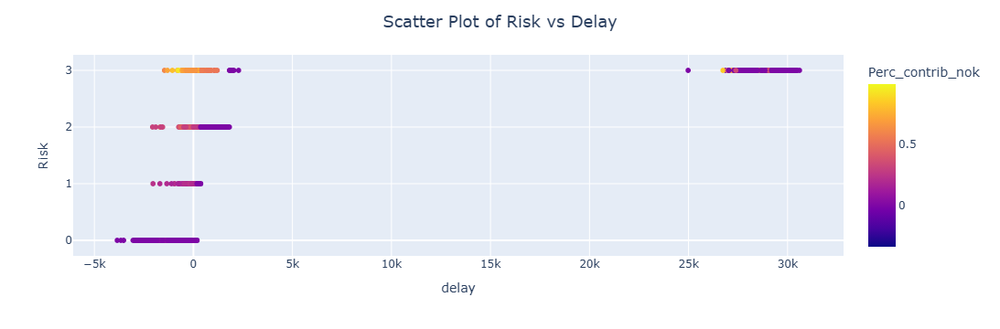

<Figure size 640x480 with 0 Axes>

In [24]:
# Scatter Plot of Risk vs Delay
fig = px.scatter(
    df_lav,
    x='delay',
    y='Risk',
    color='Perc_contrib_nok',
    hover_data=[
        'OC_STATO_PROCEDURALE',
        'OC_STATO_FINANZIARIO',
        'OC_STATO_PROGETTO',
        'COSTO_RENDICONTABILE_UE',
        'delay',
        'DEN_REGIONE_new'
    ]
)

# Add a title
fig.update_layout(
    title='Scatter Plot of Risk vs Delay',
    title_font_size=18,  
    title_x=0.5          
)

fig.show()

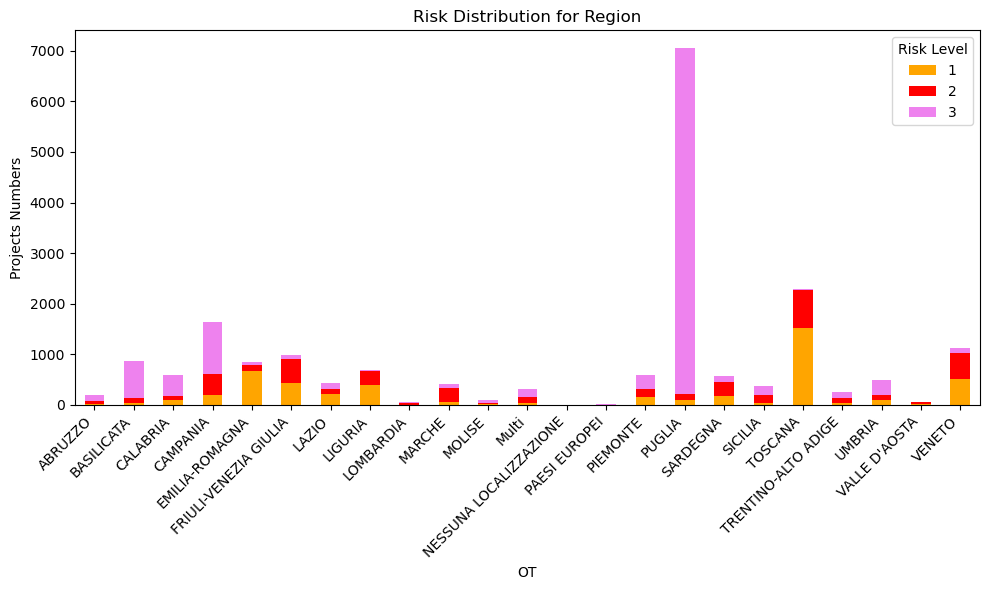

In [21]:
# Filtra i rischi "Medio" e "Alto"
filtered_df = df_lav[df_lav['Risk'].isin([3, 2, 1])]

# Raggruppa i dati per Regione e Rischio
risk_counts = filtered_df.groupby(['DEN_REGIONE_new', 'Risk']).size().unstack(fill_value=0)

# Visualizza il dataframe aggregato
#print(risk_counts)

# Creazione del grafico
risk_counts.plot(kind='bar', figsize=(10, 6), stacked=True, color=['orange', 'red','violet'])
plt.title('Risk Distribution for Region')
plt.xlabel('OT')
plt.ylabel('Projects Numbers')
plt.legend(title='Risk Level')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.savefig(r'img/Risk_Distrib_x_Region.jpeg')
# Mostra il grafico
plt.show()

### FeatureSelection

we use metadata file to understand and select prefix on the features.

In [25]:
file_path = r'Data_OC\metadati_progetti_tracciato_esteso.xlsx'
meta = pd.read_excel(file_path)

In [26]:
# as first step we go to select only features that we have at start of the project
df_lav1 = df_lav.copy()

# Variable aggregation - tabella_aggregazioni
tabella_aggregazioni = meta[['VARIABILE', 'SEZIONE']]

# dictionary with first 4 char for variables in table tabella_aggregazioni, key in lowercase
prefix_mapping = {
    row['VARIABILE'].lower(): row['SEZIONE'][:4]
    for _, row in tabella_aggregazioni.iterrows()
}

# we to iterate on df_lav1 and adding prefix if in prefix_mapping
new_column_names = []
for col in df_lav1.columns:
    col_lower = col.lower()
    if col_lower in prefix_mapping:
        new_name = f"{prefix_mapping[col_lower]}_{col}"
    else:
        new_name = f"{'New'}_{col}"
    new_column_names.append(new_name)

# Rinominare le colonne nella prima tabella
df_lav1.columns = new_column_names

# Mostrare il risultato
#print([df_lav1])


In [27]:
df_lav1 = df_lav1.loc[:, ~df_lav1.columns.str.startswith("Fina")]
#print(df_lav1)

In [28]:
col_names = df_lav1.columns

# Converte i nomi delle colonne in un DataFrame
col_names_df = pd.DataFrame(col_names)

# Salva i nomi delle colonne in un file Excel
col_names_df.to_excel(r'data_output\Col_names.xlsx', index=False, header=False)

## features selection:

- For those whose first 4 characters are "Anag", remove: Anag_cod_locale_progetto and Anag_oc_link.
- For those whose first 4 characters are "Prog" or "Altr", only keep those containing the string "COD".
- For those whose first 4 characters are "Terr", only keep those containing the string "DEN".
- For those whose first 4 characters are "Temp", "Avan", "Proc", "Indi", "Flag", or "Aggi", remove them all.
- For those whose first 4 characters are "Sogg", only keep Sogg_OC_DENOM_BENEFICIARIO and Sogg_OC_DESCR_FORMA_GIU_BENEFICIARIO.
- For those whose first 4 characters are "New_", keep them all.

In [29]:
# Copia del DataFrame originale per evitare modifiche in-place (opzionale)
df_lav1_originale = df_lav1.copy()

In [30]:
df_lav1.head()

,Anag_cod_locale_progetto,Anag_cup,Anag_oc_titolo_progetto,Anag_oc_sintesi_progetto,Anag_oc_link,Prog_OC_COD_CICLO,Prog_OC_DESCR_CICLO,Prog_OC_COD_TEMA_SINTETICO,Prog_OC_TEMA_SINTETICO,Prog_OC_COD_FONTE,Prog_OC_DESCR_FONTE,Prog_FONDO_COMUNITARIO,Prog_OC_CODICE_PROGRAMMA,Prog_OC_DESCRIZIONE_PROGRAMMA,Prog_COD_OB_TEMATICO,Prog_DESCR_OB_TEMATICO,Prog_COD_PRIORITA_INVEST,Prog_DESCR_PRIORITA_INVEST,Prog_OC_COD_CATEGORIA_SPESA,Prog_OC_DESCR_CATEGORIA_SPESA,Prog_OC_ARTICOLAZIONE_PROGRAMMA,Prog_OC_SUBARTICOLAZIONE_PROGRAMMA,Prog_OC_COD_ARTICOLAZ_PROGRAMMA,Prog_OC_DESCR_ARTICOLAZ_PROGRAMMA,Prog_OC_COD_SUBARTICOLAZ_PROGRAMMA,Prog_OC_DESCR_SUBARTICOLAZ_PROGRAMMA,Prog_COD_STRUMENTO,Prog_DESCR_STRUMENTO,Prog_DESCR_TIPO_STRUMENTO,Altr_CUP_COD_NATURA,Altr_CUP_DESCR_NATURA,Altr_CUP_COD_TIPOLOGIA,Altr_CUP_DESCR_TIPOLOGIA,Altr_CUP_COD_SETTORE,Altr_CUP_DESCR_SETTORE,Altr_CUP_COD_SOTTOSETTORE,Altr_CUP_DESCR_SOTTOSETTORE,Altr_CUP_COD_CATEGORIA,Altr_CUP_DESCR_CATEGORIA,Altr_OC_COD_TIPO_AIUTO,Altr_OC_DESCR_TIPO_AIUTO,Terr_COD_REGIONE,Terr_DEN_REGIONE,Terr_COD_PROVINCIA,Terr_DEN_PROVINCIA,Terr_COD_COMUNE,Terr_DEN_COMUNE,Terr_OC_MACROAREA,Terr_OC_COD_SLL,Terr_OC_DENOMINAZIONE_SLL,Temp_OC_DATA_INIZIO_PROGETTO,Temp_OC_DATA_FINE_PROGETTO_PREVISTA,Temp_OC_DATA_FINE_PROGETTO_EFFETTIVA,Avan_OC_STATO_FINANZIARIO,Avan_OC_STATO_PROGETTO,Avan_OC_STATO_PROCEDURALE,Avan_OC_COD_FASE_CORRENTE,Avan_OC_DESCR_FASE_CORRENTE,Proc_COD_PROCED_ATTIVAZIONE,Proc_DESCR_PROCED_ATTIVAZIONE,Proc_COD_TIPO_PROCED_ATTIVAZIONE,Proc_DESCR_TIPO_PROCED_ATTIVAZIONE,Sogg_OC_CODFISC_PROGRAMMATORE,Sogg_OC_DENOM_PROGRAMMATORE,Sogg_OC_COD_FORMA_GIU_PROGRAMMATORE,Sogg_OC_DESCR_FORMA_GIU_PROGRAMMATORE,Sogg_OC_TOTALE_PROGRAMMATORI,Sogg_OC_CODFISC_BENEFICIARIO,Sogg_OC_DENOM_BENEFICIARIO,Sogg_OC_COD_FORMA_GIU_BENEFICIARIO,Sogg_OC_DESCR_FORMA_GIU_BENEFICIARIO,Sogg_OC_TOTALE_BENEFICIARI,Indi_OC_TOTALE_INDICATORI,Indi_COD_INDICATORE_1,Indi_DESCR_INDICATORE_1,Indi_UNITA_MISURA_INDICATORE_1,Indi_PROGRAMMATO_INDICATORE_1,Indi_REALIZZATO_INDICATORE_1,Flag_OC_FLAG_VISUALIZZAZIONE,Flag_OC_FLAG_PAC,Aggi_DATA_AGGIORNAMENTO,New_Fonte_Calc,New_delay,New_prj_duration_pred,New_Perc_contrib_nok,New_marginal_cost,New_DEN_REGIONE_new,New_DEN_PROVINCIA_new,New_DEN_COMUNE_new,New_Risk
0,11FR103176,D59F20000220007,INFORMATIZZAZIONE E POTENZIAMENTO DEI PROCESSI,LA SOCIETÃ INTENDE AGGIORNARE IL PROPRIO SIST...,www.opencoesione.gov.it/progetti/11fr103176,2.0,Ciclo di programmazione 2014-2020,01,Ricerca e innovazione,FS1420,Fondi Strutturali relativi alla programmazione...,FESR,2014IT16RFOP009,POR FESR FRIULI-VENEZIA GIULIA,01,"Rafforzare la ricerca, lo sviluppo tecnologico...",1b,Promuovere gli investimenti delle imprese in R...,056,"Investimenti in infrastrutture, capacitÃ e at...",ASSE,OBIETTIVO SPECIFICO,1,"Rafforzare la Ricerca, lo sviluppo tecnologico...",1,Incremento dell'attivitÃ di innovazione delle...,01,PROGRAMMA OPERATIVO 2014-2020,STRUMENTI ATTUAZIONE DIRETTA,07,CONCESSIONE DI INCENTIVI AD UNITA' PRODUTTIVE,01,Nuova realizzazione,06,"OPERE, IMPIANTI ED ATTREZZATURE PER ATTIVITA' ...",39,"OPERE, IMPIANTI ED ATTREZZATURE PER ATTIVITA' ...",150,"IMPIANTI, MACCHINARI ED ANNESSE OPERE MURARIE",B,Regime de minimis,006,FRIULI-VENEZIA GIULIA,006093,PORDENONE,006093033,PORDENONE,Centro-Nord,611.0,PORDENONE,2020-06-30,2022-01-04,2022-01-30,Liquidato,Concluso,Eseguito,II03,Esecuzione investimenti,PRATT22956,Incentivi alle imprese per attivitÃ di indust...,1,Bando,80014930327,REGIONE AUTONOMA FRIULI-VENEZIA GIULIA,2.4.10,Regione,1.0,00204600936,DENA LINE S.P.A.,1.3.10,Societa' per azioni,1.0,6.0,101,Numero di imprese che ricevono un sostegno,Numero,1.0,1.0,0.0,0.0,2024-08-31,FS1420_FESR,26,553,0.0,126.644298,FRIULI-VENEZIA GIULIA,PORDENONE,PORDENONE,0
1,11FR103178,D89F20000420007,PROST3SIS (PROGETTO OTTIMIZZAZIONE STAMPA 3D S...,IL PROGETTO PROST3SIS ÃŠ LA NATURALE PROSECUZI...,www.opencoesione.gov.it/progetti/11fr103178,2.0,Ciclo di programmazione 2014-2020,01,Ricerca e innovazione,FS1420,Fondi Strutturali relativi all

In [31]:
# 1. Per le colonne che iniziano con 'Anag', elimina specifiche colonne
#df_lav1 = df_lav1.drop(columns=['Anag_cod_locale_progetto', 'Anag_oc_link','Anag_cup', 'Anag_oc_titolo_progetto','Anag_oc_sintesi_progetto' ],
#                       errors='ignore')
df_lav1 = df_lav1.drop(columns=['Anag_cod_locale_progetto', 'Anag_oc_link','Anag_cup', 'Anag_oc_titolo_progetto'],
                       errors='ignore')

# 2. Per le colonne che iniziano con 'Prog' o 'Altr', mantieni solo quelle che contengono '_COD_'
prog_altr_cols = df_lav1.columns[df_lav1.columns.str.startswith(('Prog', 'Altr'))]
#cols_to_drop = prog_altr_cols[~prog_altr_cols.str.contains('_COD_')]
cols_to_drop1 = prog_altr_cols[~prog_altr_cols.str.contains('_COD_CATEGORIA_SPESA|CUP_COD_NATURA|_CUP_COD_SETTORE|COD_TIPO_AIUTO', regex=True)]
df_lav1 = df_lav1.drop(columns=cols_to_drop1, errors='ignore')

# 3. Elimina tutte le colonne che iniziano con 'Temp', 'Avan', 'Proc', 'Indi', 'Flag', 'Aggi', 'Terr'
elim_prefixes = ('Temp', 'Avan', 'Proc', 'Indi', 'Flag', 'Aggi', 'Terr')
elim_cols = df_lav1.columns[df_lav1.columns.str.startswith(elim_prefixes)]
df_lav1 = df_lav1.drop(columns=elim_cols, errors='ignore')

# 4. Per le colonne che iniziano con 'Sogg', mantieni solo specifiche colonne
sogg_cols_to_keep = ['Sogg_OC_DESCR_FORMA_GIU_BENEFICIARIO', 'Sogg_OC_DENOM_PROGRAMMATORE']
sogg_cols = df_lav1.columns[df_lav1.columns.str.startswith('Sogg')]
cols_to_drop2 = sogg_cols[~sogg_cols.isin(sogg_cols_to_keep)]
df_lav1 = df_lav1.drop(columns=cols_to_drop2, errors='ignore')

# 5. Per le colonne che iniziano con 'New_', mantieni tutte solo specifiche colonne
new_cols = df_lav1.columns[df_lav1.columns.str.startswith(('New'))]
cols_to_drop3 = new_cols[new_cols.str.contains('New_Fonte_Calc|New_delay|New_Perc_contrib_nok', regex=True)]
df_lav1 = df_lav1.drop(columns=cols_to_drop3, errors='ignore')
df_lav1['Sogg_OC_DESCR_FORMA_GIU_BENEFICIARIO'] = df_lav1['Sogg_OC_DESCR_FORMA_GIU_BENEFICIARIO'].str.replace(r'[^\w\s]', '', regex=True)
df_lav1['Sogg_OC_DENOM_PROGRAMMATORE'] = df_lav1['Sogg_OC_DENOM_PROGRAMMATORE'].str.replace(r'[^\w\s]', '', regex=True)


for col in df_lav1.select_dtypes(include=['object']).columns:
    df_lav1[col] = df_lav1[col].astype('category')
df_lav1.to_csv('data_output/df_lav1.csv')

# Visualizza il DataFrame aggiornato
df_lav1.head()

,Anag_oc_sintesi_progetto,Prog_OC_COD_CATEGORIA_SPESA,Altr_CUP_COD_NATURA,Altr_CUP_COD_SETTORE,Altr_OC_COD_TIPO_AIUTO,Sogg_OC_DENOM_PROGRAMMATORE,Sogg_OC_DESCR_FORMA_GIU_BENEFICIARIO,New_prj_duration_pred,New_marginal_cost,New_DEN_REGIONE_new,New_DEN_PROVINCIA_new,New_DEN_COMUNE_new,New_Risk
0,LA SOCIETÃ INTENDE AGGIORNARE IL PROPRIO SIST...,056,07,06,B,REGIONE AUTONOMA FRIULIVENEZIA GIULIA,Societa per azioni,553,126.644298,FRIULI-VENEZIA GIULIA,PORDENONE,PORDENONE,0
1,IL PROGETTO PROST3SIS ÃŠ LA NATURALE PROSECUZI...,057,07,06,B,REGIONE AUTONOMA FRIULIVENEZIA GIULIA,Societa per azioni,697,281.067768,FRIULI-VENEZIA GIULIA,UDINE,SAN DANIELE DEL FRIULI,0
2,JOLANDA DE COLÃ² HA DECISO DI SFRUTTURA QUESTO...,057,07,06,B,REGIONE AUTONOMA FRIULIVENEZIA GIULIA,Societa per azioni,697,188.256815,FRIULI-VENEZIA GIULIA,UDINE,PALMANOVA,0
3,INERTIZZAZIONE MATERIALI CONTENENTI AMIANTO TR...,056,07,06,B,REGIONE AUTONOMA FRIULIVENEZIA GIULIA,Societa a responsabilita limitata,457,240.700219,FRIULI-VENEZIA GIULIA,UDINE,CODROIPO,0
4,OLSIV CAPITALIZZA I NOTEVOLI RISULTATI CHE IL ...,056,07,06,B,REGIONE AUTONOMA FRIULIVENEZIA GIULIA,Societa a responsabilita limitata,697,99.986662,FRIULI-VENEZIA GIULIA,UDINE,POVOLETTO,0


# Data preparation

file_path = r'Data\Comuni_Lav.xlsx'
df_comune = pd.read_excel(file_path)

import unidecode  # Per rimuovere accenti e caratteri speciali
import re  # Per espressioni regolari
import pandas as pd

# Funzione per pulire il testo
def pulisci_testo(testo):
    if not isinstance(testo, str):  # Ignora valori non stringa
        return testo
    testo = testo.lower().strip()  # Minuscole e rimuovi spazi
    testo = unidecode.unidecode(testo)  # Rimuovi accenti e caratteri speciali
    testo = re.sub(r'[^a-z\s]', '', testo)  # Rimuovi tutto tranne lettere e spazi
    testo = re.sub(r'\s+', ' ', testo)  # Sostituisci spazi multipli con uno singolo
    return testo

# Applica la funzione di pulizia ai dati
df_lav1['New_DEN_COMUNE_new'] = df_lav1['New_DEN_COMUNE_new'].apply(pulisci_testo)
df_comune['Comune'] = df_comune['Comune'].apply(pulisci_testo)

df_lav1 = df_lav1.merge(df_comune[['Comune', 'Cluster_Comune']], 
                        left_on='New_DEN_COMUNE_new', 
                        right_on='Comune', 
                        how='left')
non_trovate = df_lav1[df_lav1['Cluster_Comune'].isnull()]

if not non_trovate.empty:
    print("Corrispondenze non trovate:")
    print(non_trovate['New_DEN_COMUNE_new'].unique())
    print(non_trovate['New_DEN_COMUNE_new'].value_counts().sum())
    print(non_trovate['New_Risk'].value_counts())
else:
    print("Tutte le corrispondenze sono state trovate.")

df_save = df_lav1.copy()
df_save = df_save.drop(columns=['Comune'])
df_save.to_csv('data_output/df_lav1.csv')

df_save.head()